# Urban Heat Island Detection with CLMS HRL Imperviousness Data


**Objective**: Utilize the CLMS HRL Imperviousness Density 2021 dataset to identify and analyze potential urban heat islands (UHIs).

**Description**: This notebook analyses hotspots of artificial surface sealing, characterized by extensive impervious surfaces and limited vegetation. These regions tend to retain more heat, creating urban heat islands--zones that experience significantly higher average temperatures compared to their surroundings. By utilizing CLMS HRL Imperviousness Density data alongside custom land surface temperature data, the notebook demonstrates how higher imperviousness contributes to elevated temperatures. It provides insights into the correlation between impervious surfaces and the UHI effect, highlighting the role of urbanization in temperature dynamics.

**Results and knowledge gain**:
- Develop an understanding of the Urban Heat Island (UHI) effect and its contributing factors.
- Visually explore correlations between imperviousness and land surface temperature, supported by interactive visualizations and maps.
- Derive basic statistics to quantify the relationship between imperviousness and temperature.
- Learn how to identify areas at risk of UHI using the CLMS HRL Imperviousness Density 2021 dataset.

## 1. Introduction

Urbanization has a profound impact on local climates, with densely built-up areas often experiencing elevated temperatures compared to their greener surroundings, a phenomenon known as the *Urban Heat Island* effect. 

Urban Heat Islands (UHIs) are a key challenge in the context of global warming and climate change adaptation. As urbanization transforms natural landscapes into built-up environments, the increase in impervious surfaces alters the local climate by modifying surface properties and energy fluxes. Consequently, urban areas such as cities and smaller municipalities become significantly warmer than their rural surroundings. The UHI effect is primarily driven by increased surface sealing, which reduces vegetation, increases heat retention, and disrupts the natural cooling processes by limiting moisture availability and enhancing heat transfer to the surrounding air. Understanding the UHI effect is critical for developing strategies to mitigate heat-related health risks and improve thermal comfort, particularly in light of the growing impacts of global and regional warming.

In this notebook, we explore UHIs across Austria by combining Imperviousness Density (IMD) data from the CLMS High-Resolution Layers (2021) with Land Surface Temperature (LST) data derived from ECOSTRESS. These datasets provide detailed insights into the distribution of artificial surfaces and their thermal impact, enabling the identification of hotspots where urbanization intensifies heat retention.

We start by installing the necessary packages used in the notebook.

In [1]:
!pip install -q numpy
!pip install -q branca
!pip install -q rasterio
!pip install -q folium
!pip install -q scipy
!pip install -q matplotlib


[notice] A new release of pip is available: 24.0 -> 24.3.1
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 24.0 -> 24.3.1
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 24.0 -> 24.3.1
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 24.0 -> 24.3.1
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 24.0 -> 24.3.1
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 24.0 -> 24.3.1
[notice] To update, run: pip install --upgrade pip


We cab now import the required libraries. Most of the functions that we will use are custom-defined, and they are located in the `/modules` directory.
Additionally, below we also define constant variables that will be used throughout the notebook. 

In [2]:
import numpy as np

from modules.regions_dict import regions_dict
from modules.utils import choose_region, choose_lower_bound
from modules.images import visualize_datasets
from modules.maps import show_on_map, display_side_by_side
from modules.analysis import calculate_statistics, plot_histograms, generate_scatter_plot, analyze_masked_area

# path to CLMS HRL Imperviousness layer  
path_to_imd = 'datasets/CLMS_HRLNVLCC_IMD_S2021_R10m_AT_3035_V1_R0_20230731.tif' # TBD! hardcoded

# path to Land Surface Temperature 2023 composite layer
path_to_lst = 'datasets/2023_LST_AT_merged_composite_mean_70m_3035.tif' # TBD! choose year?

# variables used throughout the notebook
imd_label = 'IMD'
lst_label = 'LST'
imd_layer_name = 'Imperviousness degree (%)'
lst_layer_name = 'Land surface temperature (°C)'

# path to rasters directory
rasters_dir = 'rasters/'

### Imperviousness density (IMD)

Impervious surfaces are artificial structures such as roads, buildings, and rooftops [1]. Imperviousness Density (IMD) is a high-resolution dataset provided by the Copernicus Land Monitoring Service (CLMS) that quantifies the degree of surface sealing caused by these artificial structures [2]. It is provided on  10-meter resolution, with each pixel representing the percentage of imperviousness in a 10 meter x 10 meter cell. 

Impervious surfaces are an environmental concern because they disrupt urban climates in multiple ways. For example, they increase heat retention, reduce water absorption, and deprive tree roots of aeration, all of which contribute to the formation of UHIs and higher temperatures in the cities. The IMD dataset thus offers important insights into urbanization patterns and their environmental impacts. 

For this notebook, we use the CLMS High-Resolution Layers Imperviousness Density 2021 product, which provides complete spatial coverage of Austria. The product is located in the `/IMD` repository, and the full path to it is stored in the variable `path_to_imd`. The following cell visualizes IMD over the entire extent of Austria (**note**: the execution of the following cell is slow due to a large 10-meter resolution dataset):

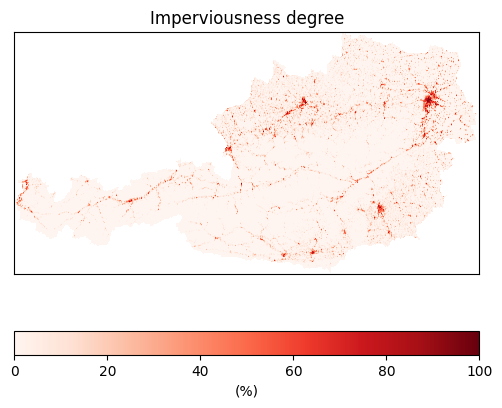

In [2]:
plot_label = ' '.join(imd_layer_name.split(' ')[:-1])
colorbar_label = imd_layer_name.split(' ')[-1]

imd_visualiztion_setup = {'path':path_to_imd, 'color':'Reds', 'plot_label': plot_label, 'colorbar_label': colorbar_label, 'clim': (0, 100)}
visualize_datasets([imd_visualiztion_setup], figure_size=(6, 5))

The image reveals clear patterns of urbanization, with cities and densely populated areas standing out due to their high imperviousness density (IMD) values. Urban centers are easily identifiable as IMD hotspots, while most rural and non-urban areas exhibit low or vanishing IMD values, reflecting the dominance of unsealed (natural or agricultural) landscapes.

### Land surface temperature (LST)

Land surface temperature (LST) is a widely used variable for investigating the climate-change-induced phenomena, providing insights into the surface radiative properties of different land cover types and the impact of urbanization on local climate characteristics. This makes it particularly useful as a proxy for identifying UHI effect. LST data is available from gridded data (e.g., Earth-observation (EO)-based retrieval), with the resolution depending on the satellite sensor. ECOsystem Spaceborne Thermal Radiometer Experiment on Space Station (ECOSTRESS) is an  ongoing NASA scientific mission mounted on the International Space Station which provides medium spatial resolution LST data (70 m) [3]. 

Due to cloud cover, sensor artefats, and infrequent sensor overpasses, the availability of ECOSTRESS data is reduced. We therefore make use of a synthetic LST dataset, generated from ECOSTRESS by utilizing a deep-learning aproach (see Ref. [4]). For this notebook, we use the LST composite 2023 product, which provides mean summer-afternoon temperatures and complete spatial coverage of Austria on a 70-meter resolution. The product is located in the `/LST_composites` repository, and the full path to it is stored in the variable `path_to_lst`. The following cell visualizes LST over the entire extent of Austria:

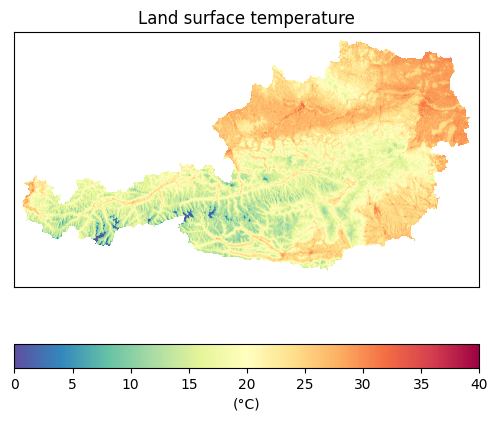

In [3]:
plot_label = ' '.join(lst_layer_name.split(' ')[:-1])
colorbar_label = lst_layer_name.split(' ')[-1]

lst_visualization_setup = {'path':path_to_lst,'color':'Spectral_r', 'plot_label': plot_label, 'colorbar_label': colorbar_label, 'clim': (0, 40)}
visualize_datasets([lst_visualization_setup], figure_size=(6, 5))

The image reveals clear spatial patterns influenced by topography and urbanization. Lower-altitude regions, such as valleys and plains, generally exhibit higher temperatures compared to the cooler mountainous areas, where elevation plays a significant role in reducing surface temperatures. Cities are visible as hotspots, with distinct higher LST values compared to surrounding nonurban areas. 

### Selection of area for further analysis

The variable `regions_dict` imported from `/modules/regions_dict.py` contains information about all the cities and areas avaialble for analysis in this notebook. Let us display the full list of options available in `regions_dict`:

In [3]:
print(f'Areas available for analysis:')
for i, region in enumerate(regions_dict.keys()):
    print(f'    {i+1}. {region}')

Areas available for analysis:
    1. Innsbruck
    2. Vienna
    3. Lower Austria
    4. all (NOT recommended)


We can choose a specific area for analysis in the remainder of this notebook using the dropdown menu provided below:

In [4]:
chosen_region = choose_region(regions_dict) 

Dropdown(description='Region:', options=('Innsbruck', 'Vienna', 'Lower Austria', 'all (NOT recommended)'), val…

**Note**: While it is possible to analyze the entire Austria-wide dataset, this is not recommended due to the lengthy processing times associated with the large IMD dataset.

## 2. Visualization of IMD and LST datasets for the selected area

In this section, we visualize the IMD and LST datasets for the area selected in the dropdown menu.

The cell below generates two interactive maps using the `folium` library and a custom-defined function `display_side_by_side()` from the module `/module/maps.py`, overlaying the IMD and LST data on an OpenStreetMap base map:

/home/kustura@geoville.local/anaconda3/envs/gdal/lib/python3.8/site-packages/IPython/core/display.py:431: UserWarning: Consider using IPython.display.IFrame instead
  warnings.warn("Consider using IPython.display.IFrame instead")



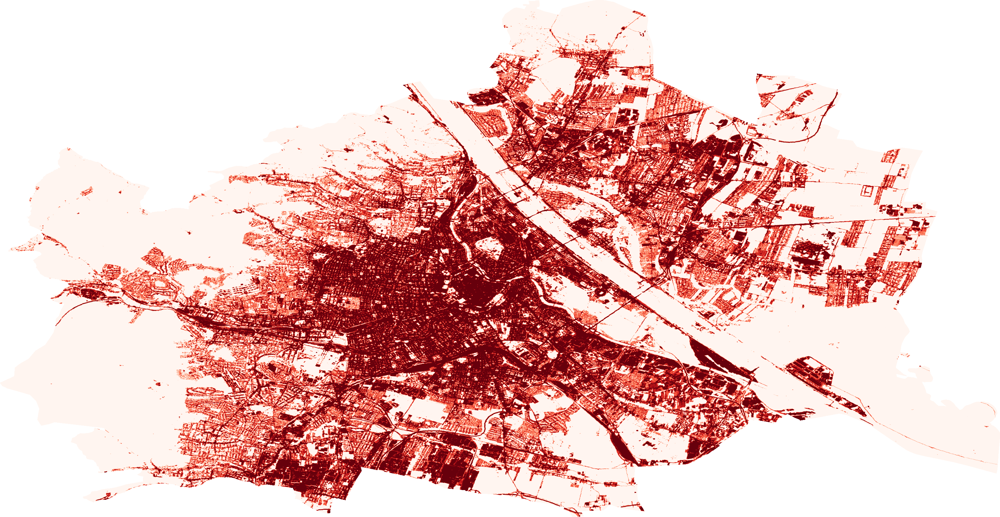
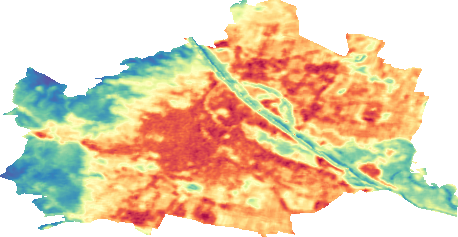

In [5]:
base_map = 'OpenStreetMap'

imd_map_setup = {'label': imd_label, 'layer_name': imd_layer_name, 'color_code': 'Reds', 'opacity': 1, 'folium_color': 'Reds_09', 'reverse': False}
m_imd = show_on_map(rasters_dir, chosen_region[0], base_map, [imd_map_setup])

lst_map_setup = {'label': lst_label, 'layer_name': lst_layer_name, 'color_code': 'Spectral_r', 'opacity': 1, 'folium_color': 'Spectral_04', 'reverse': True}
m_lst = show_on_map(rasters_dir, chosen_region[0], base_map, [lst_map_setup])

display_side_by_side(m_imd, m_lst)

In the above maps, IMD data is displayed using a red color scale (`Reds`), highlighting areas with varying degrees of surface sealing. The LST data is displayed using a spectral color scale (`Spectral_r`), with warmer areas appearing in brighter colors. These maps allow for side-by-side comparison, providing a clear visual representation of the spatial relationship between surface sealing and temperature variations in the selected region.

For an even clearer comparison, we can overlay the IMD and the LST datasets for the selected region on a single base map. To facilitate the comparison, we will set the opacity to `0.5` and choose color scales that complement each other and provide strong visual contrast (`Greys` for IMD and `plasma` for LST):


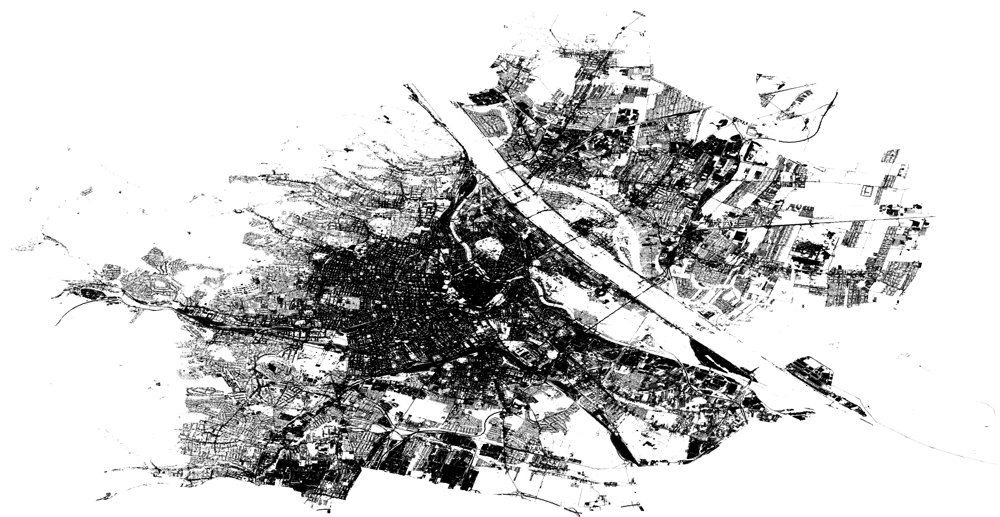
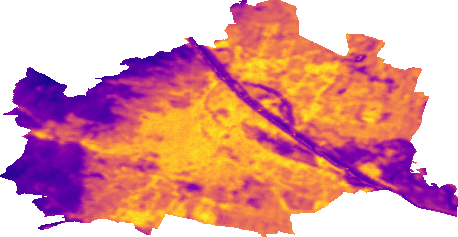

In [7]:
base_map = 'Cartodb Positron'

imd_map_properties = {'label': imd_label, 'layer_name': imd_layer_name, 'color_code': 'Greys', 'opacity': 0.5,  'folium_color': None, 'reverse': False, 'opacity': 0.5}
lst_map_properties = {'label': lst_label, 'layer_name': lst_layer_name, 'color_code': 'plasma', 'opacity': 0.5, 'folium_color': 'plasma', 'reverse': False}
m = show_on_map(rasters_dir, chosen_region[0], base_map, [imd_map_properties, lst_map_properties])

m

This map allows both datasets to be simultaneously visible, making it easier to identify spatial correlations between surface sealing and temperature variations within the region. Areas with high imperviousness density, such as city centers and urbanized zones, are characterized by elevated LST values. This correlation aligns with the known effects of urbanization, where artificial surfaces like asphalt and concrete retain heat more effectively than natural surfaces, contributing to localized temperature increases and the formation of UHIs. This demonstrates the effectiveness of the IMD dataset to correctly predict and identiy UHI hotspots.

## 3. Calculating layer statistics

In this section, we focus on summarizing and analyzing the data through statistical metrics and visualizations. 

Simple statistics such as the mean, median, and 90th percentile for both the imperviousness (IMD) and land surface temperature (LST) datasets are calculated by the following cell, using a custom-defined function `calculate_statistics()` from the module `/module/analysis.py`:

In [8]:
imd_stats = calculate_statistics(rasters_dir, chosen_region[0], imd_label, exclude_values=[0])
lst_stats = calculate_statistics(rasters_dir, chosen_region[0], lst_label, exclude_values=[])

print(f"{imd_layer_name}\nMean: {imd_stats['mean']:.2f}, Median: {imd_stats['median']:.2f}, 90th Percentile: {imd_stats['percentile_90']:.2f}\n")
print(f"{lst_layer_name}\nMean: {lst_stats['mean']:.2f}, Median: {lst_stats['median']:.2f}, 90th Percentile: {lst_stats['percentile_90']:.2f}")

Imperviousness degree (%)
Mean: 65.21, Median: 71.00, 90th Percentile: 100.00

Land surface temperature (°C)
Mean: 28.39, Median: 29.01, 90th Percentile: 31.17


Note that for IMD, values of 0 have been excluded from the dataset to prevent their dominance, which could skew the distribution towards non-built=up areas, which are not the main focus of this tutorial.

Mean value of IMD indicates the average impervious coverage of the selected area. In urban area, median is typically larger than the mean, signifying that the distribution is skewed towards higher imperviousness values. In fact, a very high value of the 90th percentile (typically close to 100% in urban areas) indicates that a significant portion of the region is fully impervious, consistent with the urbanization trends of the selected area. **[TBD - this discussion may be different if non urban areas are considered; change is needed!]**

For LST, the mean and median values can indicate the skewness of the temperature distribution: if the median is higher than the mean, the distribution is skewed toward warmer temperatures, and vice versa. 

### Histograms

A more detailed way to visualize the distribution of both IMD and LST values across the area is by plotting histograms. We use a custom-defined function `plot_histograms()` from the module `/module/analysis.py`, and plot the IMD histogram:

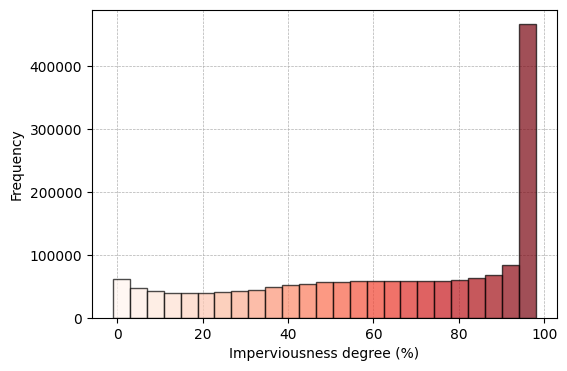

In [9]:
histogram_setups =[
    {'label': imd_label, 'layer_name': imd_layer_name, 'color_code': 'Reds', 'exclude_values': [np.nan, 0]},
]

plot_histograms(rasters_dir, chosen_region[0], histogram_setups, figure_size=(6, 4), log_scale=False)

In the IMD histogram, the value of IMD = 100 occurs much more frequently than any other value. This is due to the presence of large, fully urbanized areas within the selected region. In urban environments, the degree of imperviousness—representing surfaces like roads, buildings, and other human-made structures—often reaches its maximum value of 100%. This is particularly true for city centers and densely built-up regions, where nearly all the land surface is impervious. As a result, many of the data points in the IMD dataset correspond to these fully urbanized areas, leading to a high frequency of the 100% value.

This dominance of the IMD = 100 value can skew the histogram and obscure the distribution of other values. To obtain a clearer view of the distribution of non-zero and non-100 IMD values, we will exclude values of IMD = 100 in the next cell and redo the histogram, which helps to focus on the variation of imperviousness in less developed or partially urbanized areas, where the impervious surface coverage is not as extreme.

We plot the IMD histogram, excluding 0 and 100 values, and the LST histogram, in the following cell:

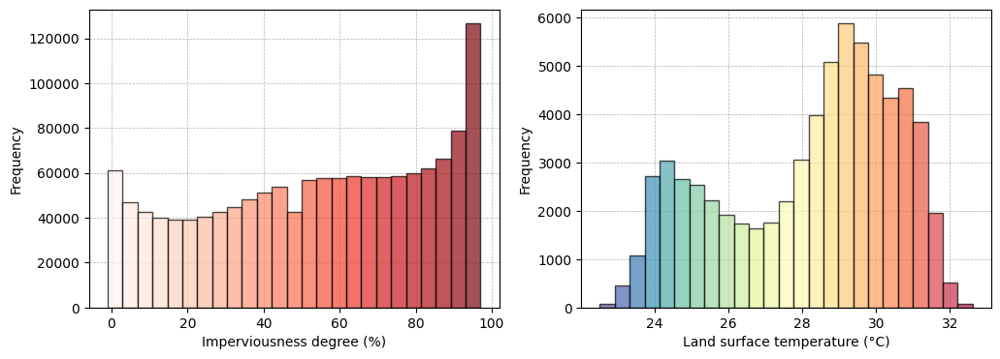

In [10]:
histogram_setups =[
    {'label': imd_label, 'layer_name': imd_layer_name, 'color_code': 'Reds', 'exclude_values': [np.nan, 0, 100]},
    {'label': lst_label, 'layer_name': lst_layer_name, 'color_code': 'Spectral_r', 'exclude_values': [np.nan]} 
]

plot_histograms(rasters_dir, chosen_region[0], histogram_setups, figure_size=(12, 4), log_scale=False)

The filtered IMD histograms now gives a better insight into the distribution of paritially built-up areas. The LST histogram displays the distribution of temperatures, and highlights any skewnes towards colder or warmer temperatures, depending on the selected region.

### Scatter plot: correlation between IMD and LST

To further investigate the relationship between IMD and LST, we generate a scatter plot using a custom-defined function  `generate_scatter_plot()` from the module `/module/analysis.py`. Here, LST values are grouped by the unique IMD values. Namely, for each unique IMD value, we compute the mean LST corresponding to all IMD pixels with that value. The calculated values of mean LST per IMD value are plotted on a scatter plot:

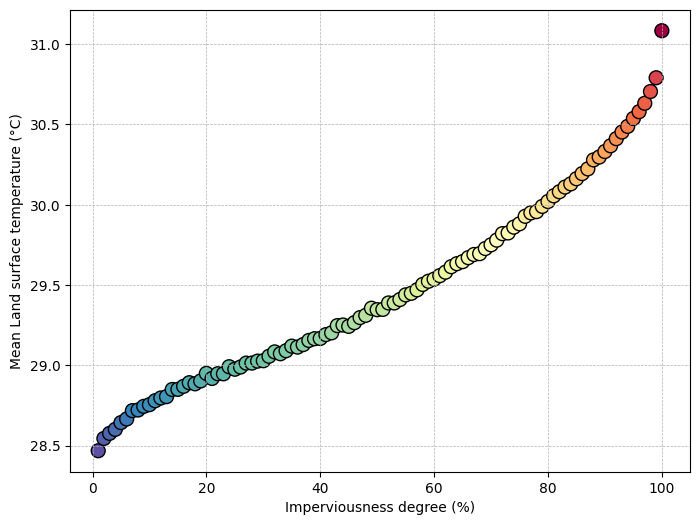

In [11]:
generate_scatter_plot(rasters_dir, chosen_region[0], imd_layer_name, lst_layer_name, filter_outliers=True, exclude_values=[0], log_scale=False)

This visualization provides insights into how imperviousness influences local temperatures, with highr degree of soil sealing contrbuting to higher LST, thus further emphasizing the impact of urbanization on climate conditions.

## 4. Exploring urban heat islands

In this section, we analyze the emergence of UHIs and their relationship with impervious surfaces. 

We start by selecting an LST treshold (`lst_treshold`) from the dropdown menu:

In [12]:
lst_limits = (calculate_statistics(rasters_dir, chosen_region[0], lst_label, [])['min'], calculate_statistics(rasters_dir, chosen_region[0], lst_label, [])['percentile_90'])
lst_treshold = choose_lower_bound(lst_limits, description = 'Min. LST (°C)')    

Dropdown(description='Min. LST (°C)', options=(22, 24, 26, 28, 30, 32), value=22)

For the minimum treshold `lst_treshold` chosen above, we proceed to 
- display the filtered map that highlights areas exceeding `lst_treshold`, and
- calculate the IMD and the LST statistics for the filtered area

Through this exploration, we aim to examine the spatial distribution of the LST values based on the selected treshold, as well as the impact of the treshold on the statisitcs of the filtered area.

Selected LST minimum threshold: 28 °C

Imperviousness degree (%)
Mean: 65.36, Median: 72.00, 90th Percentile: 100.00

Land surface temperature (°C)
Mean: 29.94, Median: 29.86, 90th Percentile: 31.40



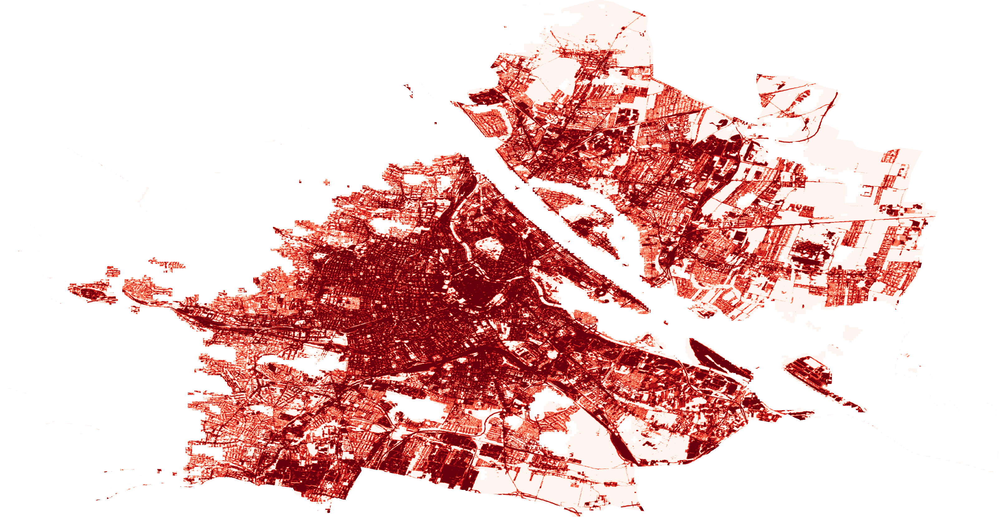
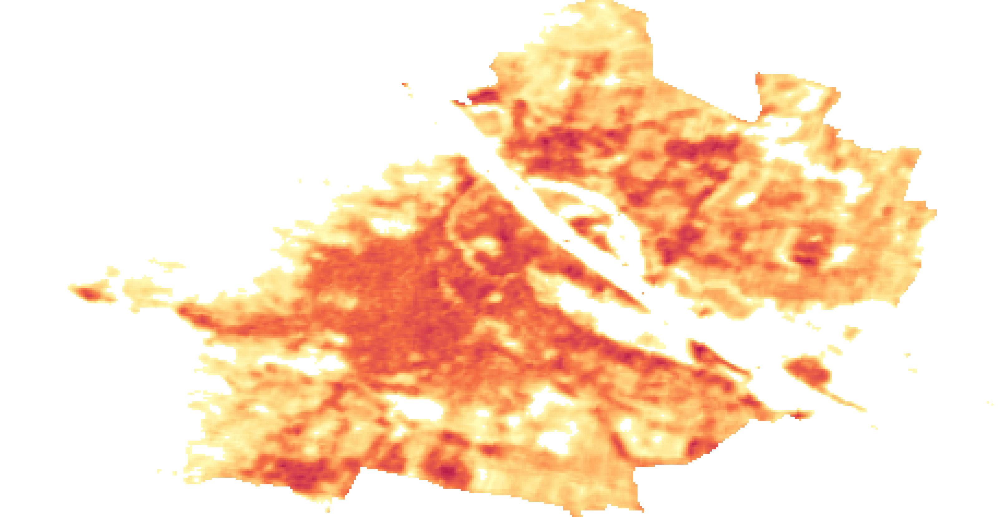

In [13]:
print(f"Selected LST minimum threshold: {lst_treshold[0]:.0f} °C\n")   
analyze_masked_area(rasters_dir, chosen_region[0], lst_treshold[0], (lst_limits[0], lst_limits[1]+2), imd_layer_name, lst_layer_name)   

This analysis provides insights into the relationship between elevated temperatures and imperviousness. In particular, the results highlight an important trend: as the temperature threshold for defining a UHI increases, the mean and median IMD values in these areas also increase. This demonstrates that regions with higher surface temperatures are generally more impervious, and reinforces the link between impervious surfaces and the emergence of UHIs, as these sealed surfaces retain heat and reduce cooling effects such as evapotranspiration.





## 5. Imperviousness as the metric of urban heat island intensity

In this final section, we analyze the UHI effect by selecting a minimum threshold for imperviousness (`imd_treshold`) from the dropdown menu:

In [14]:
# TBD!!! turn into slider?
imd_limits = (0,95)
imd_treshold = choose_lower_bound(imd_limits, description = 'Min IMD (%)', step=10)    

Dropdown(description='Min IMD (%)', options=(0, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100), value=0)

Similarly to the analysis in the previous section, by selecting a minimum threshold for IMD `imd_treshold`, we filter the LST map to display only those regions for which IMD values exceed `imd_treshold`. Additionally, we calculate the IMD and the LST statistics for the filtered area. 

As the threshold `imd_treshold` increases, the map progressively highlights areas with higher imperviousness, and we observe how these areas correspond to elevated temperatures.

Selected IMD minimum threshold: 50%

Imperviousness degree (%)
Mean: 82.79, Median: 87.00, 90th Percentile: 100.00

Land surface temperature (°C)
Mean: 30.26, Median: 30.46, 90th Percentile: 31.59



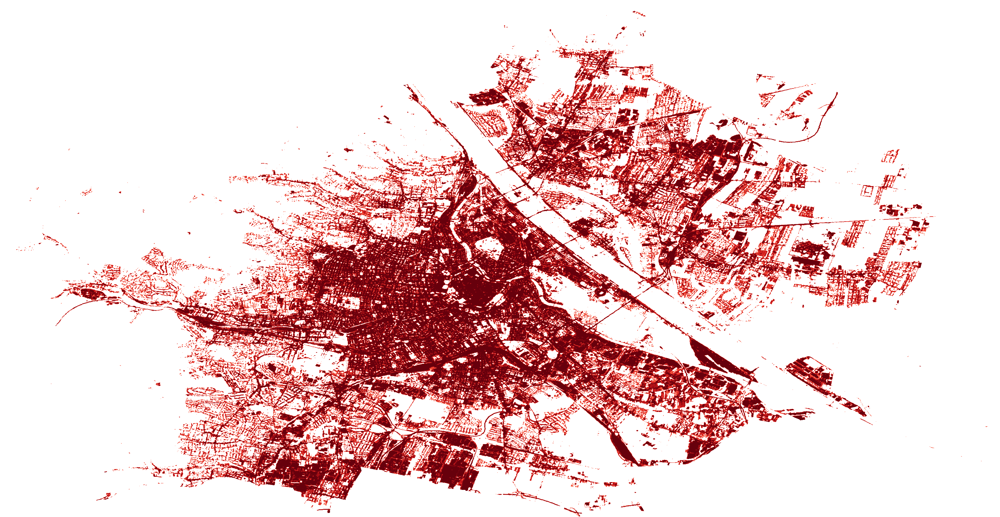
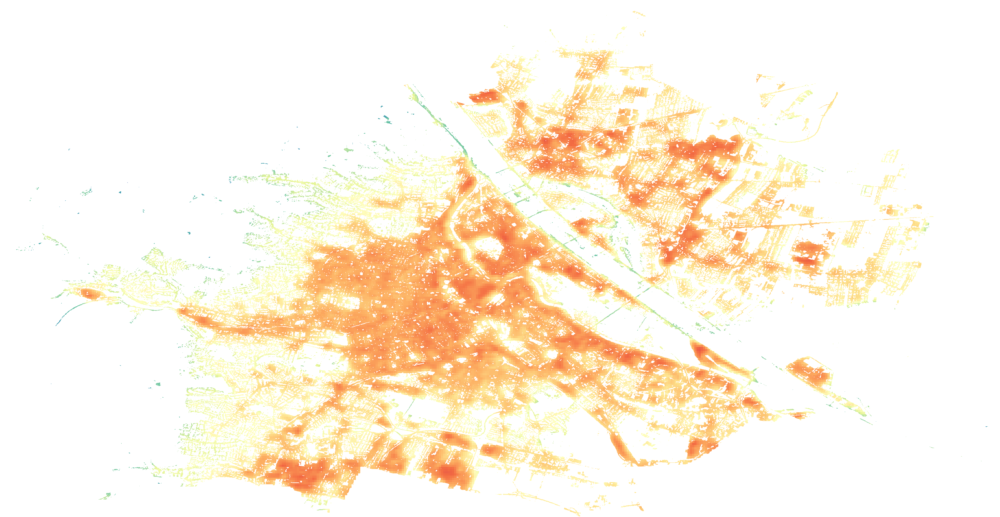

In [15]:
print(f"Selected IMD minimum threshold: {imd_treshold[0]:.0f}%\n")
lst_limits = (calculate_statistics(rasters_dir, chosen_region[0], lst_label, [])['min'], calculate_statistics(rasters_dir, chosen_region[0], lst_label, [])['max'])
analyze_masked_area(rasters_dir, chosen_region[0], imd_treshold[0], (lst_limits[0], lst_limits[1]+2), imd_layer_name, lst_layer_name, mask_by='IMD')

The analysis demonstrates a clear relationship between increasing imperviousness and higher LST. At lower IMD thresholds, the dataset includes a mix of urban and non-urban areas, resulting in more moderate average LST values. However, as the IMD threshold increases, the focus shifts to predominantly urbanized regions with dense surface sealing, where heat retention is greater due to reduced vegetation, limited cooling from evapotranspiration, and the thermal properties of impervious materials.

These results highlight that areas with higher surface sealing are consistently warmer, which is an indication of the role of impervious surfaces in intensifying the UHI effect. This pattern demonstrates how imperviousness can serve as a robust indicator of the UHI effect and urban heat intensity.

## Summary

In this notebook, we explored the interplay between imperviousness (IMD) and land surface temperature (LST), focusing on their role in understanding and analyzing Urban Heat Islands (UHIs). Here is a brief recap of the key insights and knowledge gain:

- The concept of Urban Heat Islands (UHIs) has been introduced, and its importance in the context of climate adaptation and global warming mitigation has been clarified. 
- IMD and LST datasets have been explored visually, and a clear correlation of higher IMD degree and higher LST values to the urbanized areas (cities, roads, buildings) has been observed.
- Simple statistical metrics (mean, median, 90th percentile) and histograms have been calculated, providing further insight into the distribution of IMD and LST values.
- By defining LST and IMD thresholds, we have isolated areas characterized by the UHI effect.
- We have observed that regions with higher IMD consistently exhibited higher LST values, demonstrating that imperviousness serves as a reliable metric for assessing UHI intensity and urban heat dynamics.

Key Takeaways:
1. Imperviousness is a critical factor driving the UHI effect, as it directly contributes to increased heat retention and reduced cooling from vegetation.
2. The strong correlation between IMD and LST highlights the potential of using surface sealing as an indicator for identifying and quantifying UHIs.
3. Visualization and statistical analysis of IMD and LST data provide valuable insights for urban planning, enabling targeted strategies to mitigate UHI effects.

## References

[1] Impervious surface. Available online: https://en.wikipedia.org/wiki/Impervious_surface (accessed on 19 December 2024). 

[2] Copernicus Land Monitoring Service. Available online: https://land.copernicus.eu (accessed on 19 December 2024).

[3] Hulley, G.; Freepartner, R. *ECOsystem Spaceborne Thermal Radiometer Experiment on Space Station (ECOSTRESS): Mission Level 2 Product User Guide*. California Institute of Technology: Jet Propulsion Laboratory (2019).

[4] Kustura, K.; Conti, D.; Sammer, M.; Riffler, M. *Harnessing Multi-Source Data and Deep Learning for High-Resolution Land Surface Temperature Gap-Filling Supporting Climate Change Adaptation Activities*. 
DOI:10.20944/preprints202411.0908.v1. URL: https://www.preprints.org/manuscript/202411.0908/v1 (2024).